<a href="https://colab.research.google.com/github/Olamidedurodola/Airline-Data-Challenge/blob/main/Capital_One_Data_Challenge.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## **Data Loading**

In [ ]:
#importing libraries
import pandas as pd
import requests
from zipfile import ZipFile
import matplotlib.pyplot as plt

In [ ]:

def merge_datasets(url):
    # Download and extract the data from the provided link
    response = requests.get(url)
    with open('data.zip', 'wb') as f:
        f.write(response.content)

    with ZipFile('data.zip', 'r') as zip_ref:
        zip_ref.extractall('data')  # Extract the contents to 'data' directory

    # Load the datasets as pandas DataFrames
    airport_codes_df = pd.read_csv('data/Airport_Codes.csv')
    flights_df = pd.read_csv('data/Flights.csv')
    tickets_df = pd.read_csv('data/Tickets.csv')

    # Merge Flights dataset with Airport Codes dataset based on 'origin'
    flights_with_airport_codes = flights_df.merge(
        airport_codes_df,
        left_on='ORIGIN',
        right_on='IATA_CODE',
        how='inner'
    )

    # Convert the 'FL_DATE' column in Flights DataFrame to date
    flights_with_airport_codes['FL_DATE'] = pd.to_datetime(flights_with_airport_codes['FL_DATE'])

    # Convert the 'YEAR' column in Tickets DataFrame to date
    tickets_df['YEAR'] = pd.to_datetime(tickets_df['YEAR'].astype(str))

    # Create a new column 'dest_orig' by concatenating 'origin' and 'destination' columns with a different delimiter (e.g., 'origin_destination')
    flights_with_airport_codes['dest_orig'] = flights_with_airport_codes['ORIGIN'] + '_' + flights_with_airport_codes['DESTINATION']

    # Merge the above DataFrame with Tickets dataset based on the specified join conditions
    merged_dataset = flights_with_airport_codes.merge(
        tickets_df,
        left_on=['FL_DATE', 'ORIGIN', 'DESTINATION', 'OP_CARRIER'],
        right_on=['YEAR', 'ORIGIN', 'DESTINATION', 'REPORTING_CARRIER'],
        how='inner'
    )

    return merged_dataset


In [ ]:
# File path of the dataset
data_url = 'https://github.com/CapitalOneRecruiting/DA-Airline-Data-Challenge/raw/main/data.zip'
# Call the function to download, extract, and merge the data
merged_data = merge_datasets(data_url)

# Display the DataFrame
merged_data


<ipython-input-2-8b371ec63201>:12: DtypeWarning: Columns (3,13,14) have mixed types. Specify dtype option on import or set low_memory=False.
  flights_df = pd.read_csv('data/Flights.csv')


,FL_DATE,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN,ORIGIN_CITY_NAME,DEST_AIRPORT_ID,DESTINATION,DEST_CITY_NAME,...,ITIN_ID,YEAR,QUARTER,ORIGIN_COUNTRY,ORIGIN_STATE_ABR,ORIGIN_STATE_NM,ROUNDTRIP,REPORTING_CARRIER,PASSENGERS,ITIN_FARE
0,2019-01-01,B6,N192JB,130,14635,RSW,"Fort Myers, FL",12478,JFK,"New York, NY",...,201911454183,2019-01-01,1,US,FL,Florida,0.0,B6,8.0,344.0
1,2019-01-01,B6,N192JB,130,14635,RSW,"Fort Myers, FL",12478,JFK,"New York, NY",...,201911454167,2019-01-01,1,US,FL,Florida,0.0,B6,1.0,290.0
2,2019-01-01,B6,N192JB,130,14635,RSW,"Fort Myers, FL",12478,JFK,"New York, NY",...,201911454413,2019-01-01,1,US,FL,Florida,1.0,B6,1.0,341.0
3,2019-01-01,B6,N192JB,130,14635,RSW,"Fort Myers, FL",12478,JFK,"New York, NY",...,201911454384,2019-01-01,1,US,FL,Florida,1.0,B6,1.0,265.0
4,2019-01-01,B6,N192JB,130,14635,RSW,"Fort Myers, FL",12478,JFK,"New York, NY",...,201911454166,2019-01-01,1,US,FL,Florida,0.0,B6,1.0,289.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1924023,2019-01-01,MQ,N822AE,3355,11415,DRT,"Del Rio, TX",11298,DFW,"Dallas/Fort Worth, TX",...,201912760672,2019-01-01,1,US,TX,Texas,1.0,MQ,1.0,196.0
1924024,2019-01-01,MQ,N822AE,3355,11415,DRT,"Del Rio, TX",11298,DFW,"Dallas/Fort Worth, TX",...,201912760690,2019-01-01,1,US,TX,Texas,1.0,MQ,1.0,484.0
1924025,2019-01-01,MQ,N822AE,3355,11415,DRT,"Del Rio, TX",11298,DFW,"Dallas/Fort Worth, TX",...,201912760680,2019-01-01,1,US,TX,Texas,1.0,MQ,1.0,444.0
1924026,2019-01-01,MQ,N822AE,3355,11415,DRT,"Del Rio, TX",11298,DFW,"Dallas/Fort Worth, TX",...,201912760677,2019-01-01,1,US,TX,Texas,1.0,MQ,2.0,322.0


## **Data Transformation**

In [ ]:
merged_data.describe()

,ORIGIN_AIRPORT_ID,DEST_AIRPORT_ID,DEP_DELAY,ARR_DELAY,CANCELLED,OCCUPANCY_RATE,ELEVATION_FT,ITIN_ID,QUARTER,ROUNDTRIP,PASSENGERS
count,1.924028e+06,1.924028e+06,1.914107e+06,1.912058e+06,1.924028e+06,1.924028e+06,1.908551e+06,1.924028e+06,1924028.0,1.924028e+06,1.920196e+06
mean,1.272617e+04,1.283860e+04,9.613494e+00,2.773822e+00,5.372063e-03,6.506588e-01,6.826231e+02,1.650600e+11,1.0,6.387786e-01,3.659647e+00
std,1.488989e+03,1.456062e+03,3.690610e+01,3.943374e+01,7.309724e-02,2.030542e-01,1.210982e+03,7.319202e+10,0.0,4.803547e-01,1.172586e+01
min,1.013500e+04,1.013500e+04,-3.000000e+01,-7.000000e+01,0.000000e+00,3.000000e-01,3.000000e+00,2.019120e+05,1.0,0.000000e+00,1.000000e+00
25%,1.129800e+04,1.129800e+04,-5.000000e+00,-1.500000e+01,0.000000e+00,4.700000e-01,2.100000e+01,2.019112e+11,1.0,0.000000e+00,1.000000e+00
50%,1.289200e+04,1.289200e+04,-1.000000e+00,-6.000000e+00,0.000000e+00,6.500000e-01,1.530000e+02,2.019127e+11,1.0,1.000000e+00,1.000000e+00
75%,1.405700e+04,1.410000e+04,1.000000e+01,9.000000e+00,0.000000e+00,8.300000e-01,7.480000e+02,2.019142e+11,1.0,1.000000e+00,2.000000e+00
max,1.621800e+04,1.621800e+04,1.408000e+03,1.389000e+03,1.000000e+00,1.000000e+00,7.820000e+03,2.019153e+11,1.0,1.000000e+00,7.690000e+02


In [ ]:
# Convert all wrong numeric column to numeric format and plot histograms

def to_number(dataframe, columns):
    for column in columns:
        dataframe[column] = pd.to_numeric(dataframe[column], errors='coerce')

def hist(dataframe, name):
       # for all the numeric columns in the DataFrame
    numeric_columns = dataframe.select_dtypes(include='number').columns
    for column in numeric_columns:
        plt.figure()
        plt.hist(dataframe[column], bins=10)
        plt.xlabel(column)
        plt.ylabel('Frequency')
        plt.title(f'Histogram of {column} in {name}')
        plt.show()

# Convert specific columns of 'flights' and 'tickets' to numeric
to_number(merged_data, ["DISTANCE", "AIR_TIME", "ITIN_FARE"])


In [ ]:
merged_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1924028 entries, 0 to 1924027
Data columns (total 35 columns):
 #   Column             Dtype         
---  ------             -----         
 0   FL_DATE            datetime64[ns]
 1   OP_CARRIER         object        
 2   TAIL_NUM           object        
 3   OP_CARRIER_FL_NUM  object        
 4   ORIGIN_AIRPORT_ID  int64         
 5   ORIGIN             object        
 6   ORIGIN_CITY_NAME   object        
 7   DEST_AIRPORT_ID    int64         
 8   DESTINATION        object        
 9   DEST_CITY_NAME     object        
 10  DEP_DELAY          float64       
 11  ARR_DELAY          float64       
 12  CANCELLED          float64       
 13  AIR_TIME           float64       
 14  DISTANCE           float64       
 15  OCCUPANCY_RATE     float64       
 16  TYPE               object        
 17  NAME               object        
 18  ELEVATION_FT       float64       
 19  CONTINENT          object        
 20  ISO_COUNTRY        objec

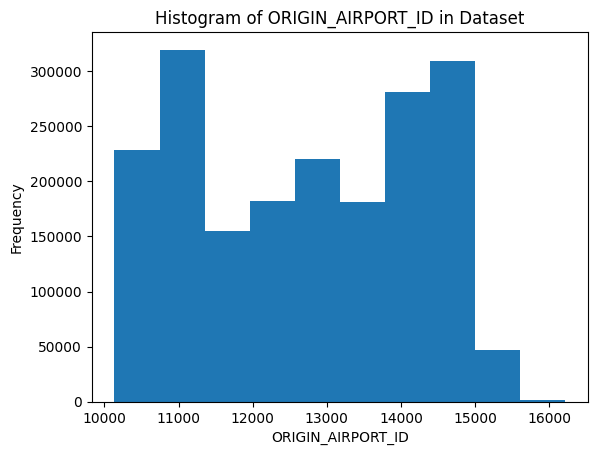

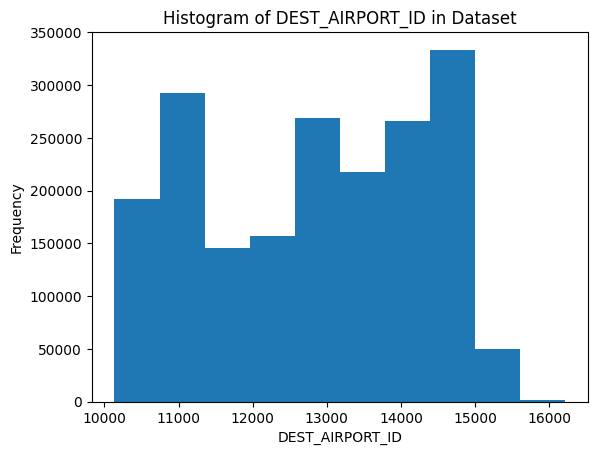

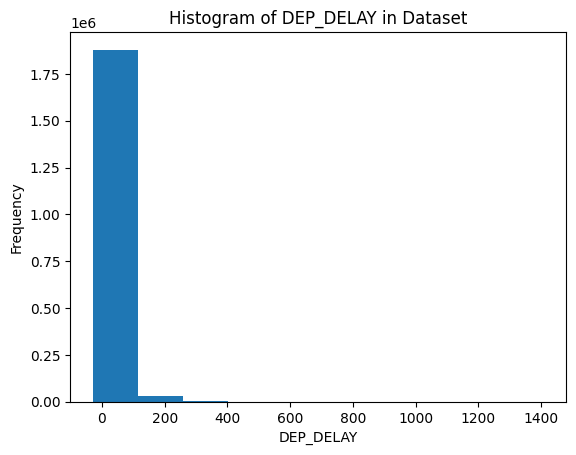

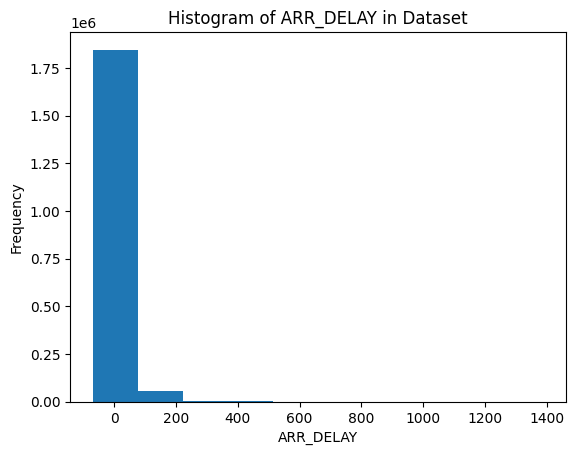

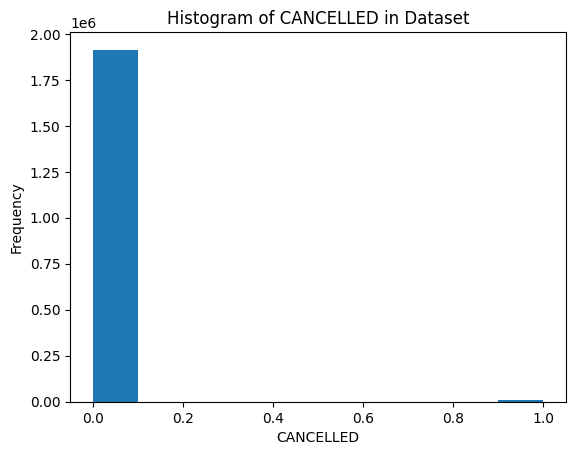

...

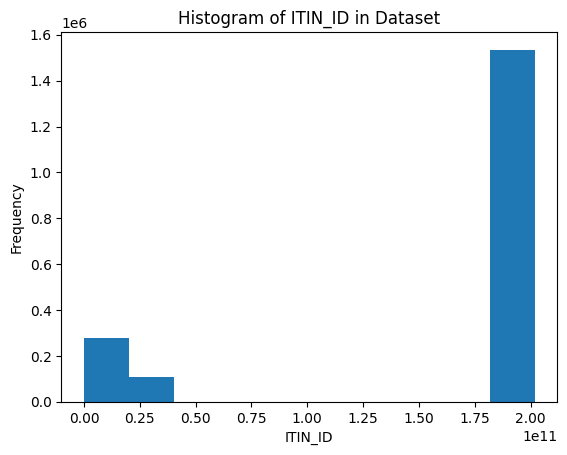

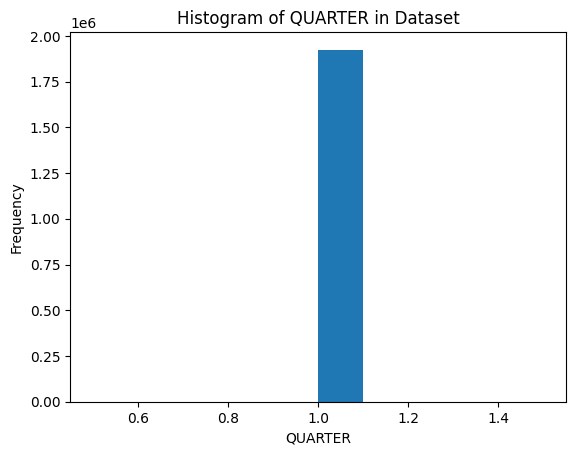

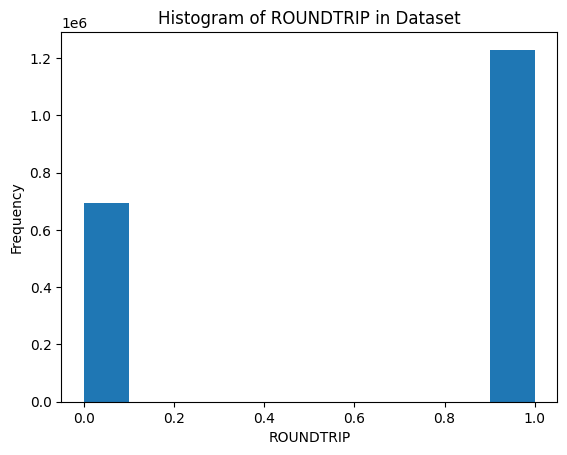

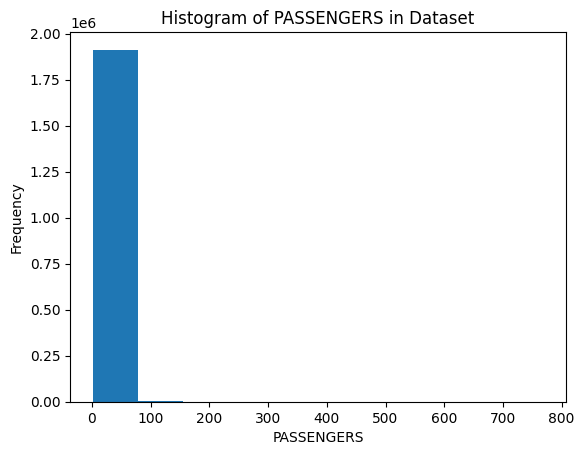

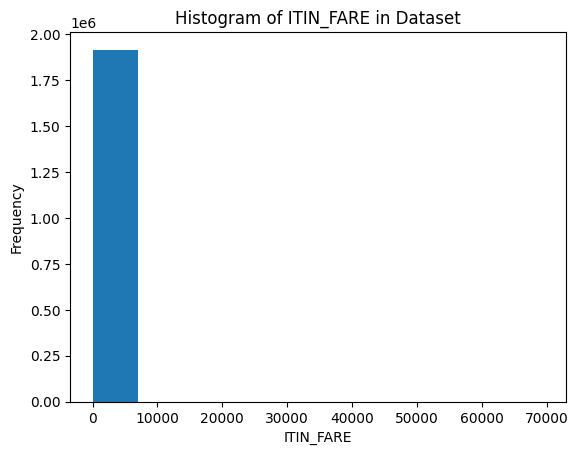

In [ ]:
# Create histograms for numeric fields
hist(merged_data, "Dataset")

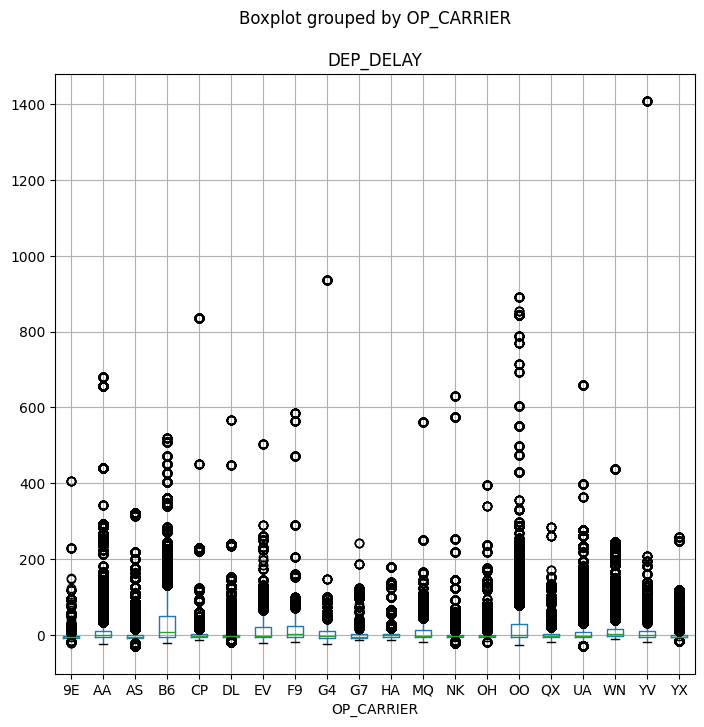

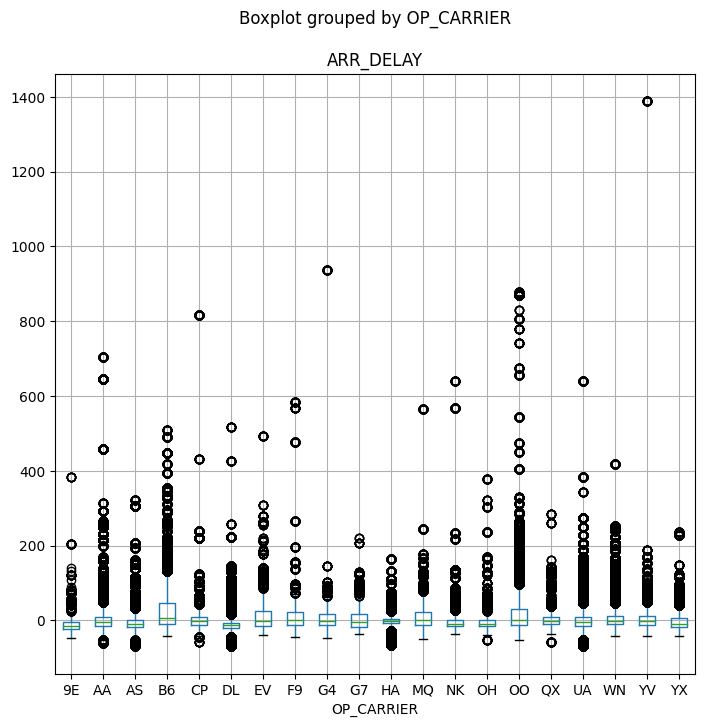

In [ ]:
# Use a for loop to check outliers for each delay field
delayFields = ['DEP_DELAY','ARR_DELAY']

for col in delayFields:
    merged_data.boxplot(column=col, by='OP_CARRIER', figsize=(8,8))

In [ ]:
"""After examining the histogram of the flights dataset, we have observed a significant number of outliers in the ARR_DELAY and DEP_DELAY columns.
Although these data points are intriguing, we will exclude any values that fall outside the 1st to 99th percentile range during our data analysis.
Instead, we will replace those outliers with the median value.

To identify the most profitable round trip routes, we will work with the flights dataset after applying the outlier removal.
Similarly, we will apply the same approach to cleanse the Fare information in the tickets dataset, as this variable is crucial for revenue calculation.
For the tickets dataset, we will use a slightly narrower population range, specifically the 1st to 95th percentile."""


import pandas as pd
import matplotlib.pyplot as plt

def remove_outliers(dataframe, columns, lower_percentile, upper_percentile):
    for column in columns:
        lower_bound = dataframe[column].quantile(lower_percentile)
        upper_bound = dataframe[column].quantile(upper_percentile)
        dataframe[column] = dataframe[column].clip(lower=lower_bound, upper=upper_bound)
        median_value = dataframe[column].median()
        dataframe[column] = dataframe[column].fillna(median_value)

def summary_statistics(dataframe):
    return dataframe.describe()

def boxplot(dataframe, column):
    plt.figure()
    plt.boxplot(dataframe[column])
    plt.xlabel(column)
    plt.title(f'Boxplot of {column}')
    plt.show()

# Clean dataset by removing outliers and replace them with median
remove_outliers(merged_data, ['ARR_DELAY', 'DEP_DELAY'], 0.01, 0.99)

# Clean dataset by removing outliers and replace them with median
remove_outliers(merged_data, ['ITIN_FARE'], 0.01, 0.95)


In [ ]:
# Display summary statistics for flights datasets
summary_statistics(merged_data)

,ORIGIN_AIRPORT_ID,DEST_AIRPORT_ID,DEP_DELAY,ARR_DELAY,CANCELLED,AIR_TIME,DISTANCE,OCCUPANCY_RATE,ELEVATION_FT,ITIN_ID,QUARTER,ROUNDTRIP,PASSENGERS,ITIN_FARE
count,1.924028e+06,1.924028e+06,1.924028e+06,1.924028e+06,1.924028e+06,1.912058e+06,1.924028e+06,1.924028e+06,1.908551e+06,1.924028e+06,1924028.0,1.924028e+06,1.920196e+06,1.924028e+06
mean,1.272617e+04,1.283860e+04,8.496372e+00,1.690719e+00,5.372063e-03,1.407157e+02,1.035323e+03,6.506588e-01,6.826231e+02,1.650600e+11,1.0,6.387786e-01,3.659647e+00,3.939795e+02
std,1.488989e+03,1.456062e+03,2.648094e+01,2.952447e+01,7.309724e-02,8.079907e+01,6.629321e+02,2.030542e-01,1.210982e+03,7.319202e+10,0.0,4.803547e-01,1.172586e+01,2.499949e+02
min,1.013500e+04,1.013500e+04,-1.300000e+01,-4.100000e+01,0.000000e+00,1.200000e+01,3.100000e+01,3.000000e-01,3.000000e+00,2.019120e+05,1.0,0.000000e+00,1.000000e+00,5.000000e+00
25%,1.129800e+04,1.129800e+04,-5.000000e+00,-1.500000e+01,0.000000e+00,7.900000e+01,5.440000e+02,4.700000e-01,2.100000e+01,2.019112e+11,1.0,0.000000e+00,1.000000e+00,2.130000e+02
50%,1.289200e+04,1.289200e+04,-1.000000e+00,-6.000000e+00,0.000000e+00,1.250000e+02,9.200000e+02,6.500000e-01,1.530000e+02,2.019127e+11,1.0,1.000000e+00,1.000000e+00,3.450000e+02
75%,1.405700e+04,1.410000e+04,9.000000e+00,8.000000e+00,0.000000e+00,1.780000e+02,1.379000e+03,8.300000e-01,7.480000e+02,2.019142e+11,1.0,1.000000e+00,2.000000e+00,5.270000e+02
max,1.621800e+04,1.621800e+04,1.480000e+02,1.420000e+02,1.000000e+00,6.210000e+02,4.983000e+03,1.000000e+00,7.820000e+03,2.019153e+11,1.0,1.000000e+00,7.690000e+02,9.950000e+02


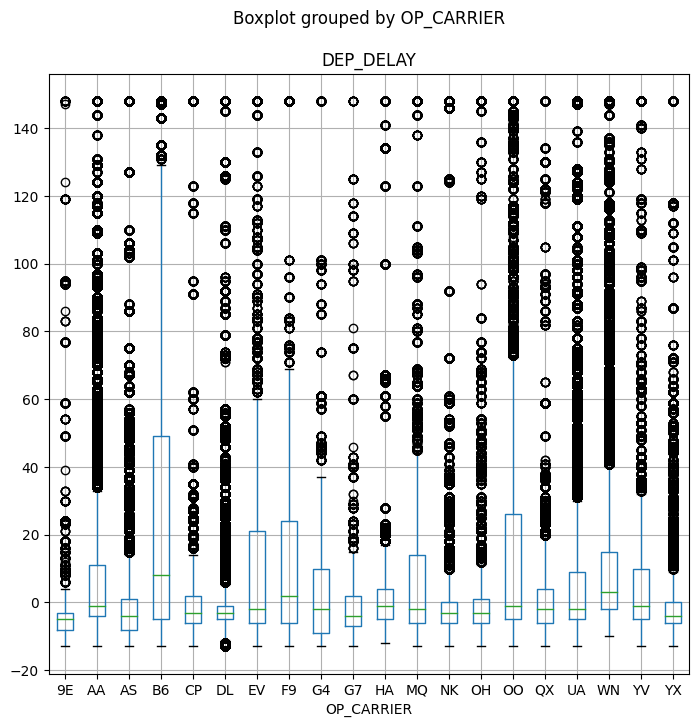

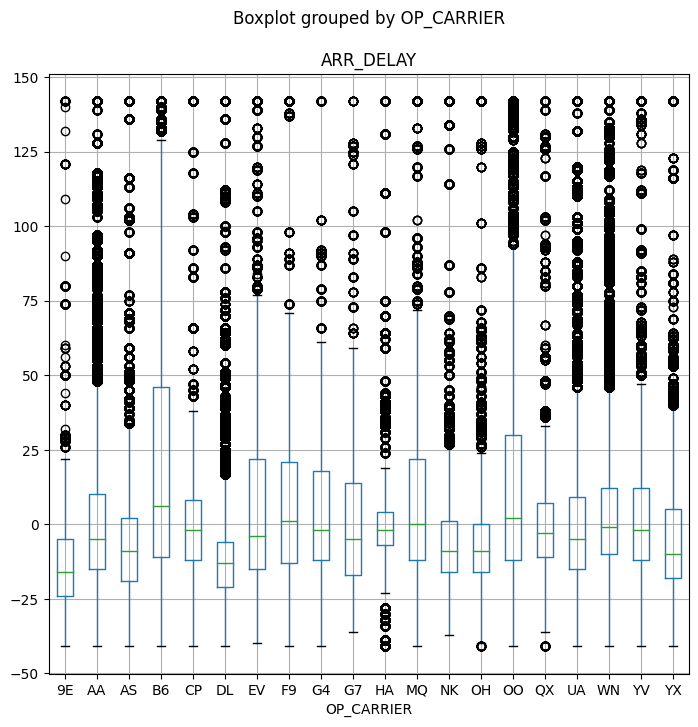

In [ ]:
# Use a for loop to check outliers for each delay field after removing outliers
delayFields = ['DEP_DELAY','ARR_DELAY']

for col in delayFields:
    merged_data.boxplot(column=col, by='OP_CARRIER', figsize=(8,8))

## **Data Cleaning**

In [ ]:
# Checking for duplicates in dataset

merged_data.isnull().sum()

FL_DATE                    0
OP_CARRIER                 0
TAIL_NUM                 148
OP_CARRIER_FL_NUM          0
ORIGIN_AIRPORT_ID          0
ORIGIN                     0
ORIGIN_CITY_NAME           0
DEST_AIRPORT_ID            0
DESTINATION                0
DEST_CITY_NAME             0
DEP_DELAY                  0
ARR_DELAY                  0
CANCELLED                  0
AIR_TIME               11970
DISTANCE                   0
OCCUPANCY_RATE             0
TYPE                       0
NAME                       0
ELEVATION_FT           15477
CONTINENT            1923238
ISO_COUNTRY                0
MUNICIPALITY           15477
IATA_CODE                  0
COORDINATES                0
dest_orig                  0
ITIN_ID                    0
YEAR                       0
QUARTER                    0
ORIGIN_COUNTRY             0
ORIGIN_STATE_ABR           0
ORIGIN_STATE_NM            0
ROUNDTRIP                  0
REPORTING_CARRIER          0
PASSENGERS              3832
ITIN_FARE     

In [ ]:
# Since there are a lot of missing data in some columns, we will drop them

columns_to_drop = ['ELEVATION_FT', 'CONTINENT', 'MUNICIPALITY']
filtered_data = merged_data.drop(columns=columns_to_drop)


In [ ]:
filtered_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1924028 entries, 0 to 1924027
Data columns (total 32 columns):
 #   Column             Dtype         
---  ------             -----         
 0   FL_DATE            datetime64[ns]
 1   OP_CARRIER         object        
 2   TAIL_NUM           object        
 3   OP_CARRIER_FL_NUM  object        
 4   ORIGIN_AIRPORT_ID  int64         
 5   ORIGIN             object        
 6   ORIGIN_CITY_NAME   object        
 7   DEST_AIRPORT_ID    int64         
 8   DESTINATION        object        
 9   DEST_CITY_NAME     object        
 10  DEP_DELAY          float64       
 11  ARR_DELAY          float64       
 12  CANCELLED          float64       
 13  AIR_TIME           float64       
 14  DISTANCE           float64       
 15  OCCUPANCY_RATE     float64       
 16  TYPE               object        
 17  NAME               object        
 18  ISO_COUNTRY        object        
 19  IATA_CODE          object        
 20  COORDINATES        objec

In [ ]:
# Drop rows with missing data

filtered_data = filtered_data.dropna()

In [ ]:
# Checking for duplicates in dataset

filtered_data.duplicated().sum()

46018

In [ ]:
#drop duplicates in the
filtered_data = filtered_data.drop_duplicates()

In [ ]:
filtered_data.describe()

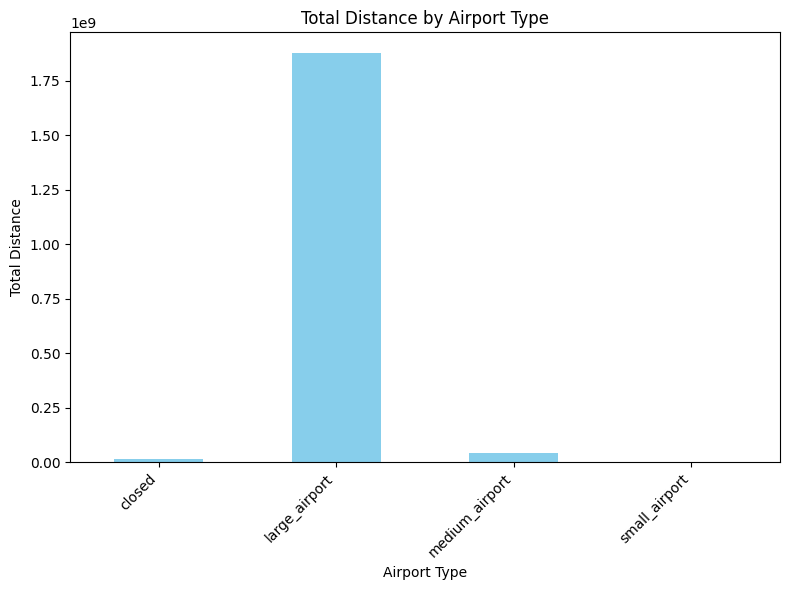

In [ ]:
# Group the data by airport type and aggregate the distance
grouped_data = filtered_data.groupby('TYPE')['DISTANCE'].sum()

# Create a bar plot based on the aggregated distances
plt.figure(figsize=(8, 6))
grouped_data.plot(kind='bar', color='skyblue')
plt.title('Total Distance by Airport Type')
plt.xlabel('Airport Type')
plt.ylabel('Total Distance')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


In [ ]:
# filter on the targer market - medium and large airports in the US

filtered_data = filtered_data[filtered_data['ISO_COUNTRY'] == 'US']


In [ ]:
filtered_on_size = filtered_data[filtered_data['TYPE'].isin(['medium_airport', 'large_airport'])]


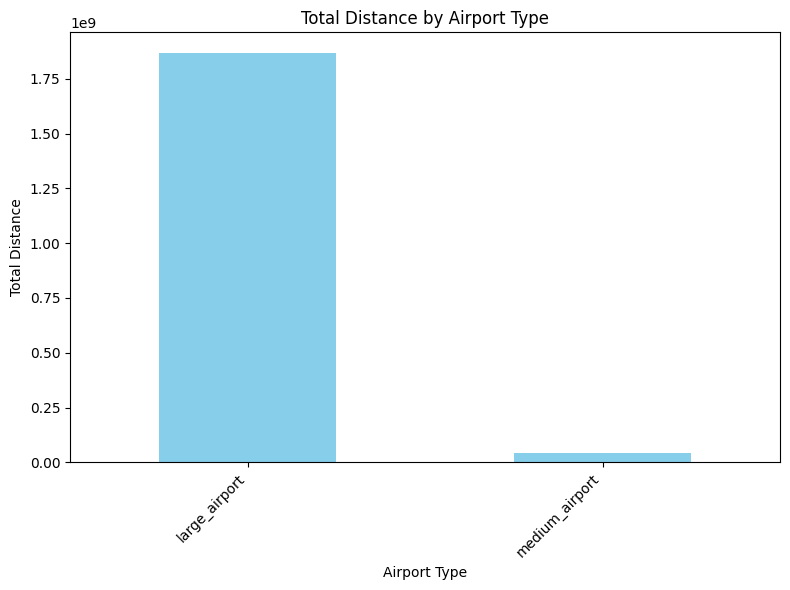

In [ ]:
# Group the data by airport type and aggregate the distance
grouped_data = filtered_on_size.groupby('TYPE')['DISTANCE'].sum()

# Create a bar plot based on the aggregated distances
plt.figure(figsize=(8, 6))
grouped_data.plot(kind='bar', color='skyblue')
plt.title('Total Distance by Airport Type')
plt.xlabel('Airport Type')
plt.ylabel('Total Distance')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


In [ ]:
filtered_on_size.describe()

,ORIGIN_AIRPORT_ID,DEST_AIRPORT_ID,DEP_DELAY,ARR_DELAY,CANCELLED,AIR_TIME,DISTANCE,OCCUPANCY_RATE,ITIN_ID,QUARTER,ROUNDTRIP,PASSENGERS,ITIN_FARE
count,1.836914e+06,1.836914e+06,1.836914e+06,1.836914e+06,1836914.0,1.836914e+06,1.836914e+06,1.836914e+06,1.836914e+06,1836914.0,1.836914e+06,1.836914e+06,1.836914e+06
mean,1.273707e+04,1.284002e+04,8.584441e+00,1.797523e+00,0.0,1.411185e+02,1.039330e+03,6.508278e-01,1.647959e+11,1.0,6.392058e-01,3.677399e+00,3.952737e+02
std,1.477572e+03,1.457529e+03,2.649850e+01,2.960889e+01,0.0,8.104861e+01,6.658528e+02,2.029886e-01,7.338923e+10,0.0,4.802311e-01,1.184278e+01,2.507162e+02
min,1.013500e+04,1.013500e+04,-1.300000e+01,-4.100000e+01,0.0,1.200000e+01,3.100000e+01,3.000000e-01,2.019120e+05,1.0,0.000000e+00,1.000000e+00,5.000000e+00
25%,1.129800e+04,1.129800e+04,-5.000000e+00,-1.500000e+01,0.0,7.900000e+01,5.450000e+02,4.700000e-01,2.019112e+11,1.0,0.000000e+00,1.000000e+00,2.130000e+02
50%,1.289200e+04,1.289200e+04,-1.000000e+00,-5.000000e+00,0.0,1.260000e+02,9.200000e+02,6.500000e-01,2.019127e+11,1.0,1.000000e+00,1.000000e+00,3.450000e+02
75%,1.405700e+04,1.410000e+04,1.000000e+01,9.000000e+00,0.0,1.790000e+02,1.379000e+03,8.300000e-01,2.019142e+11,1.0,1.000000e+00,2.000000e+00,5.290000e+02
max,1.621800e+04,1.621800e+04,1.480000e+02,1.420000e+02,0.0,6.210000e+02,4.983000e+03,1.000000e+00,2.019153e+11,1.0,1.000000e+00,7.690000e+02,9.950000e+02


In [ ]:
# Create a new column 'ROUND_TRIP_ROUTE' by concatenating 'ORIGIN' and 'DESTINATION' fields
filtered_on_size['ROUND_TRIP_ROUTE'] = filtered_on_size[['ORIGIN', 'DESTINATION']].apply(lambda x: '_'.join(sorted(x)), axis=1)
filtered_origin_dest = filtered_on_size
# filtered_origin_dest

<ipython-input-24-83bdfb4ca2e7>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_on_size['ROUND_TRIP_ROUTE'] = filtered_on_size[['ORIGIN', 'DESTINATION']].apply(lambda x: '_'.join(sorted(x)), axis=1)


## **Exploratory Data Analysis**

In [ ]:
filtered_origin_dest = filtered_origin_dest[(filtered_origin_dest['ROUNDTRIP']==1.0) ]
filtered_origin_dest

,FL_DATE,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN,ORIGIN_CITY_NAME,DEST_AIRPORT_ID,DESTINATION,DEST_CITY_NAME,...,YEAR,QUARTER,ORIGIN_COUNTRY,ORIGIN_STATE_ABR,ORIGIN_STATE_NM,ROUNDTRIP,REPORTING_CARRIER,PASSENGERS,ITIN_FARE,ROUND_TRIP_ROUTE
2,2019-01-01,B6,N192JB,130,14635,RSW,"Fort Myers, FL",12478,JFK,"New York, NY",...,2019-01-01,1,US,FL,Florida,1.0,B6,1.0,341.0,JFK_RSW
3,2019-01-01,B6,N192JB,130,14635,RSW,"Fort Myers, FL",12478,JFK,"New York, NY",...,2019-01-01,1,US,FL,Florida,1.0,B6,1.0,265.0,JFK_RSW
9,2019-01-01,B6,N192JB,130,14635,RSW,"Fort Myers, FL",12478,JFK,"New York, NY",...,2019-01-01,1,US,FL,Florida,1.0,B6,1.0,316.0,JFK_RSW
10,2019-01-01,B6,N192JB,130,14635,RSW,"Fort Myers, FL",12478,JFK,"New York, NY",...,2019-01-01,1,US,FL,Florida,1.0,B6,1.0,204.0,JFK_RSW
11,2019-01-01,B6,N192JB,130,14635,RSW,"Fort Myers, FL",12478,JFK,"New York, NY",...,2019-01-01,1,US,FL,Florida,1.0,B6,1.0,793.0,JFK_RSW
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1924008,2019-01-01,MQ,N822AE,3355,11415,DRT,"Del Rio, TX",11298,DFW,"Dallas/Fort Worth, TX",...,2019-01-01,1,US,TX,Texas,1.0,MQ,1.0,196.0,DFW_DRT
1924009,2019-01-01,MQ,N822AE,3355,11415,DRT,"Del Rio, TX",11298,DFW,"Dallas/Fort Worth, TX",...,2019-01-01,1,US,TX,Texas,1.0,MQ,1.0,484.0,DFW_DRT
1924010,2019-01-01,MQ,N822AE,3355,11415,DRT,"Del Rio, TX",11298,DFW,"Dallas/Fort Worth, TX",...,2019-01-01,1,US,TX,Texas,1.0,MQ,1.0,444.0,DFW_DRT
1924011,2019-01-01,MQ,N822AE,3355,11415,DRT,"Del Rio, TX",11298,DFW,"Dallas/Fort Worth, TX",...,2019-01-01,1,US,TX,Texas,1.0,MQ,2.0,322.0,DFW_DRT


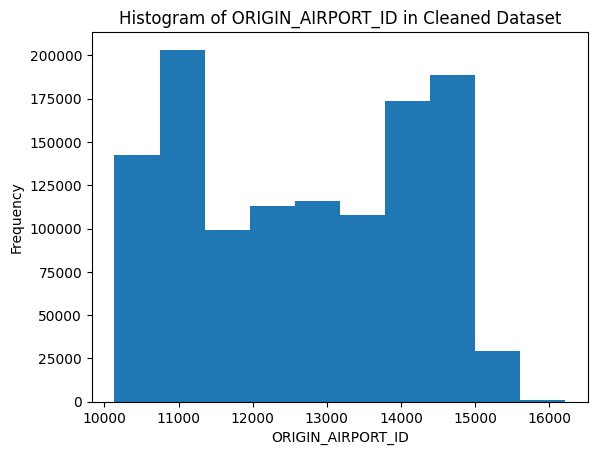

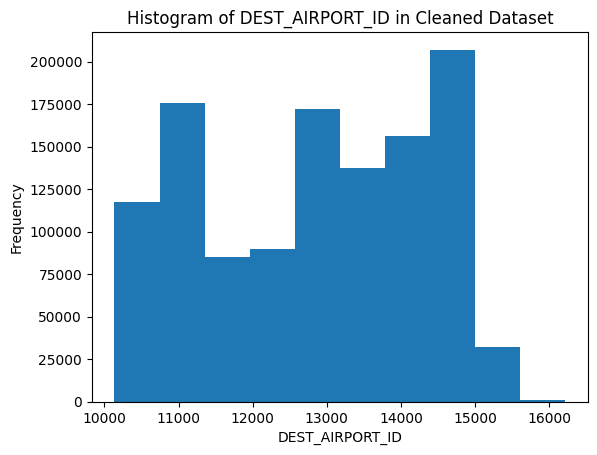

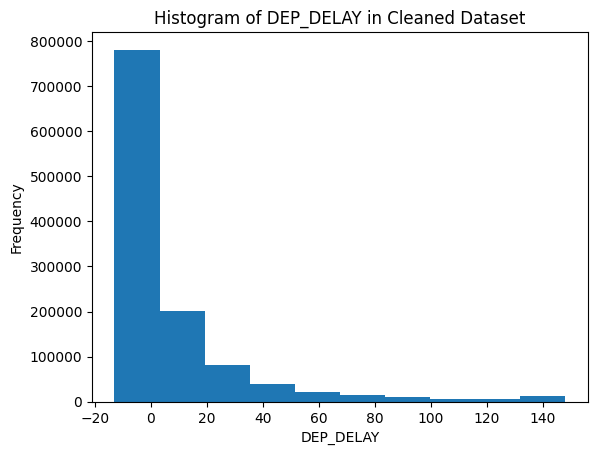

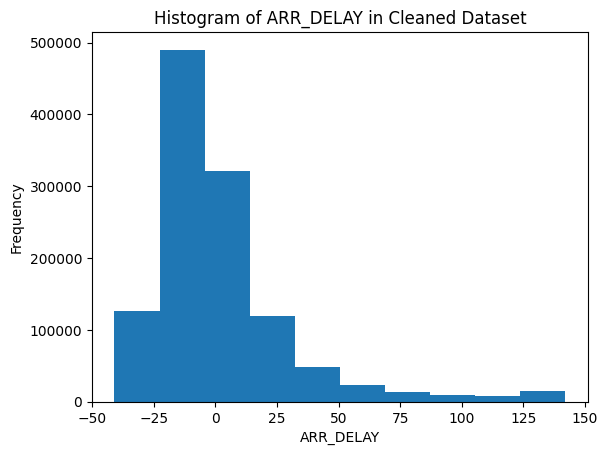

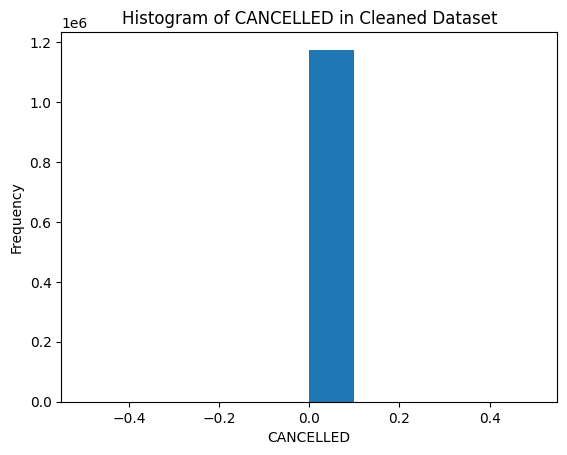

...

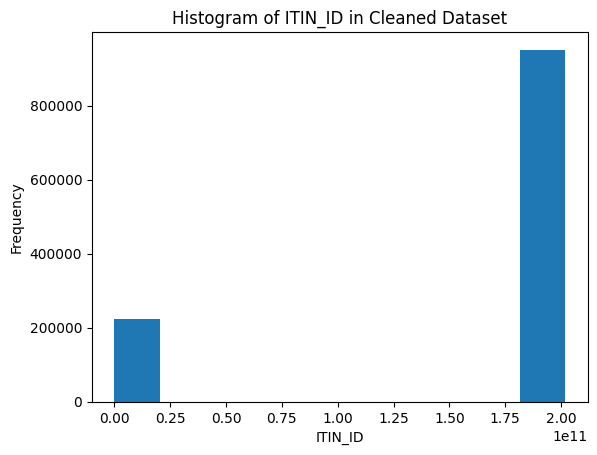

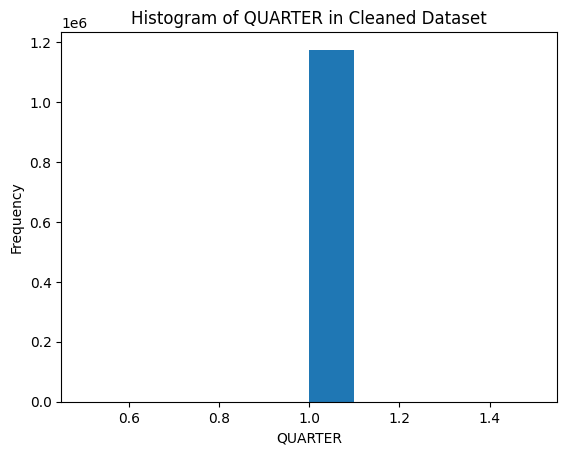

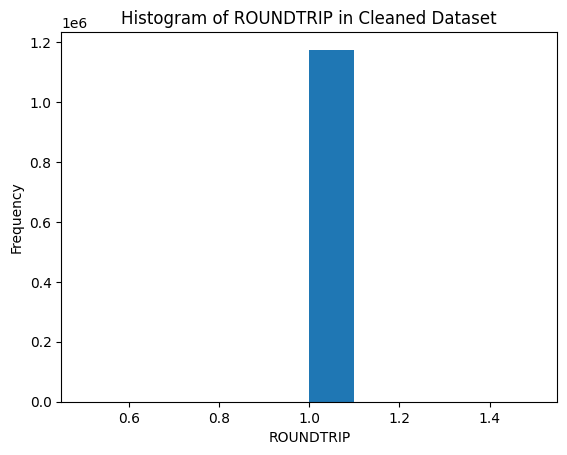

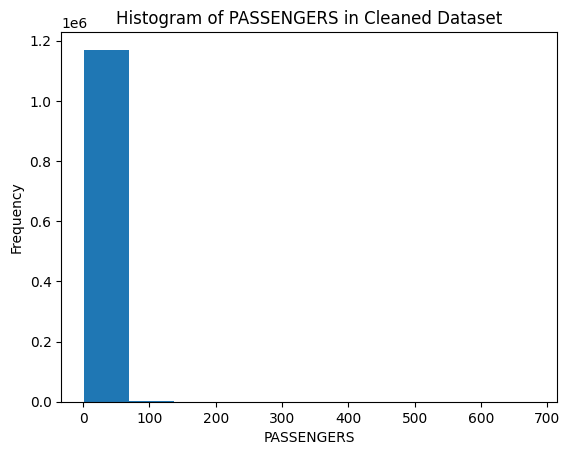

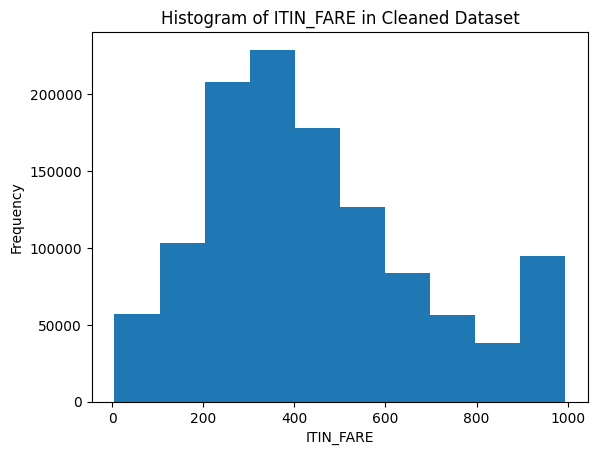

In [ ]:
hist(filtered_origin_dest, "Cleaned Dataset")

In [ ]:
filtered_origin_dest.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1174166 entries, 2 to 1924012
Data columns (total 33 columns):
 #   Column             Non-Null Count    Dtype         
---  ------             --------------    -----         
 0   FL_DATE            1174166 non-null  datetime64[ns]
 1   OP_CARRIER         1174166 non-null  object        
 2   TAIL_NUM           1174166 non-null  object        
 3   OP_CARRIER_FL_NUM  1174166 non-null  object        
 4   ORIGIN_AIRPORT_ID  1174166 non-null  int64         
 5   ORIGIN             1174166 non-null  object        
 6   ORIGIN_CITY_NAME   1174166 non-null  object        
 7   DEST_AIRPORT_ID    1174166 non-null  int64         
 8   DESTINATION        1174166 non-null  object        
 9   DEST_CITY_NAME     1174166 non-null  object        
 10  DEP_DELAY          1174166 non-null  float64       
 11  ARR_DELAY          1174166 non-null  float64       
 12  CANCELLED          1174166 non-null  float64       
 13  AIR_TIME           1174166 

## **Business Analysis**

## **10 busiest round trip routes**

In [ ]:

# Group the DataFrame by 'ROUND_TRIP_ROUTE' and store the result in a new DataFrame
grouped_data_filtered = filtered_origin_dest.groupby('ROUND_TRIP_ROUTE')

# Count the number of flights in each group and sort in descending order
sorted_grouped_data = grouped_data_filtered.size().sort_values(ascending=False)

# Display the sorted result
displayed_data = sorted_grouped_data.head(10)

# Create a new DataFrame to store the displayed data
result_df = pd.DataFrame({
    'Route': displayed_data.index,
    'Count': displayed_data.values
})

# Display the result DataFrame
result_df


,Route,Count
0,EWR_SFO,11452
1,JFK_LAX,10891
2,LAX_ORD,9713
3,LAX_SFO,8681
4,EWR_LAX,8368
5,LAX_SEA,8177
6,ORD_SFO,7888
7,ATL_LGA,7623
8,LGA_MIA,7553
9,LGA_ORD,7481


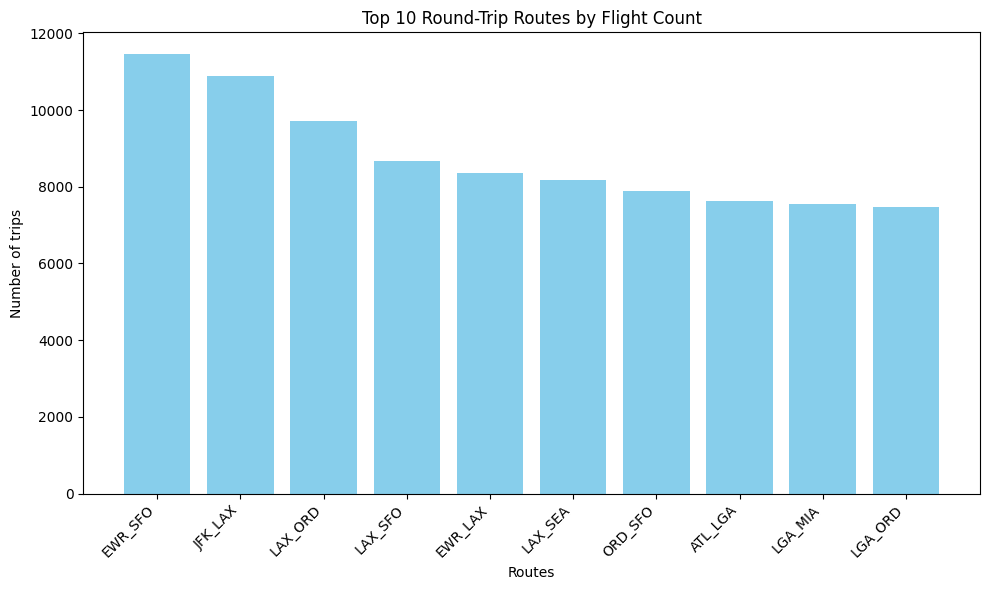

In [ ]:
# Create a bar plot
plt.figure(figsize=(10, 6))
plt.bar(result_df['Route'], result_df['Count'], color='skyblue')
plt.xlabel('Routes')
plt.ylabel('Number of trips')
plt.title('Top 10 Round-Trip Routes by Flight Count')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Display the plot
plt.show()


## **10 most profitable round trip routes**

In [ ]:
# Constants
COST_PER_MILE_FUEL_OIL_MAINTENANCE_CREW = 8
COST_PER_MILE_DEPRECIATION_INSURANCE_OTHER = 1.18
AIRPORT_COST_MEDIUM = 5000
AIRPORT_COST_LARGE = 10000
DELAY_COST_PER_MINUTE = 75
BAGGAGE_FEE_PER_BAG = 35
PASSENGER_CAPACITY = 200
BAGGAGE_CHECK_PROBABILITY = 0.5



# Calculate total revenue and total cost for each flight
filtered_origin_dest['TOTAL_REVENUE'] = filtered_origin_dest['PASSENGERS'] * filtered_origin_dest['ITIN_FARE']
filtered_origin_dest['TOTAL_COST'] = (filtered_origin_dest['PASSENGERS'] * 2 * DELAY_COST_PER_MINUTE) + \
                                     (filtered_origin_dest['PASSENGERS'] * 2 * BAGGAGE_CHECK_PROBABILITY * BAGGAGE_FEE_PER_BAG)

# Group the data by origin, destination, and quarter to get aggregated values for each route
grouped_data = filtered_origin_dest.groupby(['ROUND_TRIP_ROUTE'])

# Calculate total profit, total round trip flights, and other summary values for each route
grouped_data_summary = grouped_data.agg({
    'TOTAL_REVENUE': 'sum',
    'TOTAL_COST': 'sum',
    'PASSENGERS': 'sum',
    'ITIN_FARE': 'mean'
}).reset_index()

# Calculate the profit for each route (without considering the upfront airplane cost)
grouped_data_summary['PROFIT'] = grouped_data_summary['TOTAL_REVENUE'] - grouped_data_summary['TOTAL_COST']

# Sort the routes by profit in descending order to get the top 10 most profitable routes
top_10_routes = grouped_data_summary.sort_values(by='PROFIT', ascending=False).head(10)

# Display the top 10 most profitable routes
print("Top 10 Most Profitable Routes:")
top_10_routes


Top 10 Most Profitable Routes:


<ipython-input-33-c53cd039ac2b>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_origin_dest['TOTAL_REVENUE'] = filtered_origin_dest['PASSENGERS'] * filtered_origin_dest['ITIN_FARE']
<ipython-input-33-c53cd039ac2b>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_origin_dest['TOTAL_COST'] = (filtered_origin_dest['PASSENGERS'] * 2 * DELAY_COST_PER_MINUTE) + \


,ROUND_TRIP_ROUTE,TOTAL_REVENUE,TOTAL_COST,PASSENGERS,ITIN_FARE,PROFIT
1708,JFK_LAX,18752623.0,7701735.0,41631.0,606.804242,11050888.0
1346,EWR_SFO,15614472.0,5434560.0,29376.0,679.766329,10179912.0
1314,EWR_LAX,13311464.0,5688380.0,30748.0,599.741874,7623084.0
2179,ORD_SFO,10601185.0,4316605.0,23333.0,602.256973,6284580.0
868,DAL_HOU,13081671.0,7244415.0,39159.0,363.912162,5837256.0
1819,LAX_ORD,11493633.0,6132935.0,33151.0,481.668691,5360698.0
168,ATL_LGA,9895804.0,4806115.0,25979.0,480.334383,5089689.0
2161,ORD_PHX,9187188.0,4152325.0,22445.0,521.644653,5034863.0
165,ATL_LAX,8529517.0,3553110.0,19206.0,628.562961,4976407.0
1145,DFW_ORD,8489962.0,3606205.0,19493.0,484.173601,4883757.0


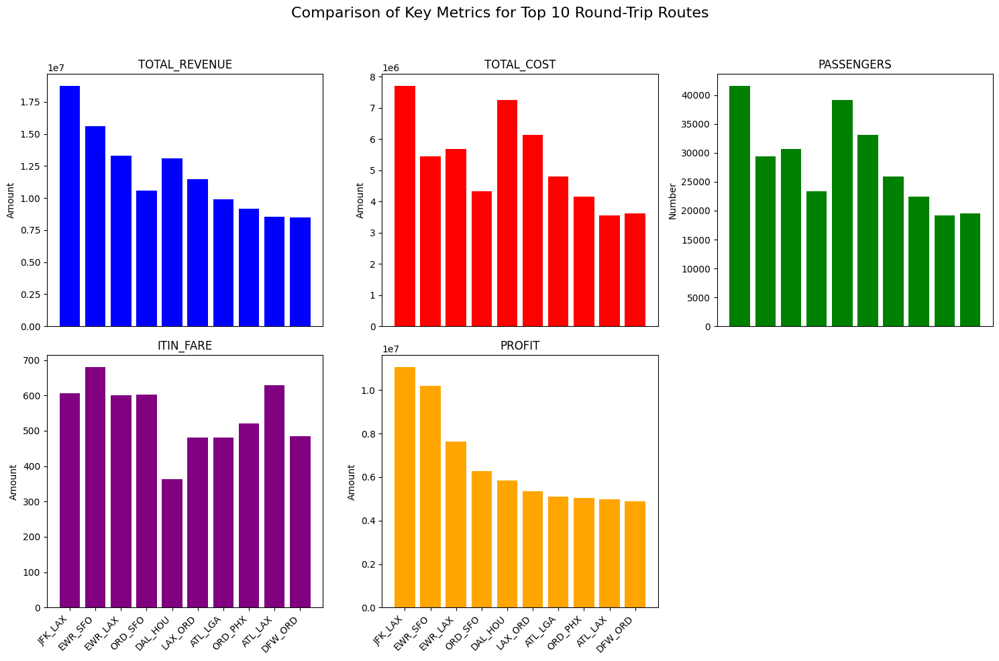

In [ ]:
import matplotlib.pyplot as plt

# Select the top 10 routes based on a specific condition (you can modify this as needed)
top_10_routes = top_10_routes

# Create subplots
fig, axes = plt.subplots(2, 3, figsize=(15, 10))
fig.suptitle('Comparison of Key Metrics for Top 10 Round-Trip Routes', fontsize=16)

# Plot TOTAL_REVENUE
axes[0, 0].bar(top_10_routes['ROUND_TRIP_ROUTE'], top_10_routes['TOTAL_REVENUE'], color='blue')
axes[0, 0].set_title('TOTAL_REVENUE')
axes[0, 0].set_xticks([])
axes[0, 0].set_ylabel('Amount')

# Plot TOTAL_COST
axes[0, 1].bar(top_10_routes['ROUND_TRIP_ROUTE'], top_10_routes['TOTAL_COST'], color='red')
axes[0, 1].set_title('TOTAL_COST')
axes[0, 1].set_xticks([])
axes[0, 1].set_ylabel('Amount')

# Plot PASSENGERS
axes[0, 2].bar(top_10_routes['ROUND_TRIP_ROUTE'], top_10_routes['PASSENGERS'], color='green')
axes[0, 2].set_title('PASSENGERS')
axes[0, 2].set_xticks([])
axes[0, 2].set_ylabel('Number')

# Plot ITIN_FARE
axes[1, 0].bar(top_10_routes['ROUND_TRIP_ROUTE'], top_10_routes['ITIN_FARE'], color='purple')
axes[1, 0].set_title('ITIN_FARE')
axes[1, 0].set_xticks(top_10_routes['ROUND_TRIP_ROUTE'])
axes[1, 0].set_xticklabels(top_10_routes['ROUND_TRIP_ROUTE'], rotation=45, ha='right')
axes[1, 0].set_ylabel('Amount')

# Plot PROFIT
axes[1, 1].bar(top_10_routes['ROUND_TRIP_ROUTE'], top_10_routes['PROFIT'], color='orange')
axes[1, 1].set_title('PROFIT')
axes[1, 1].set_xticks(top_10_routes['ROUND_TRIP_ROUTE'])
axes[1, 1].set_xticklabels(top_10_routes['ROUND_TRIP_ROUTE'], rotation=45, ha='right')
axes[1, 1].set_ylabel('Amount')

# Hide empty subplot
axes[1, 2].axis('off')

# Adjust layout
plt.tight_layout()
plt.subplots_adjust(top=0.88)

# Display the plots
plt.show()


## **Recommended 5 round trip routes**

In [ ]:
filtered_origin_dest.columns

Index(['FL_DATE', 'OP_CARRIER', 'TAIL_NUM', 'OP_CARRIER_FL_NUM',
       'ORIGIN_AIRPORT_ID', 'ORIGIN', 'ORIGIN_CITY_NAME', 'DEST_AIRPORT_ID',
       'DESTINATION', 'DEST_CITY_NAME', 'DEP_DELAY', 'ARR_DELAY', 'CANCELLED',
       'AIR_TIME', 'DISTANCE', 'OCCUPANCY_RATE', 'TYPE', 'NAME', 'ISO_COUNTRY',
       'IATA_CODE', 'COORDINATES', 'dest_orig', 'ITIN_ID', 'YEAR', 'QUARTER',
       'ORIGIN_COUNTRY', 'ORIGIN_STATE_ABR', 'ORIGIN_STATE_NM', 'ROUNDTRIP',
       'REPORTING_CARRIER', 'PASSENGERS', 'ITIN_FARE', 'ROUND_TRIP_ROUTE',
       'TOTAL_REVENUE', 'TOTAL_COST'],
      dtype='object')

In [ ]:
# Sort the routes by profit in descending order to recommend the top 5 routes to invest in
top_5_routes_to_invest = grouped_data_summary.sort_values(by='PROFIT', ascending=False).head(5)

# Display the recommended routes
print("Top 5 round trip routes to invest in based on profit:")
print(top_5_routes_to_invest[['ROUND_TRIP_ROUTE', 'PROFIT']])
top_5_routes_to_invest = top_5_routes_to_invest[['ROUND_TRIP_ROUTE', 'PROFIT']]

Top 5 round trip routes to invest in based on average occupancy rate:
     ROUND_TRIP_ROUTE      PROFIT
1708          JFK_LAX  11050888.0
1346          EWR_SFO  10179912.0
1314          EWR_LAX   7623084.0
2179          ORD_SFO   6284580.0
868           DAL_HOU   5837256.0


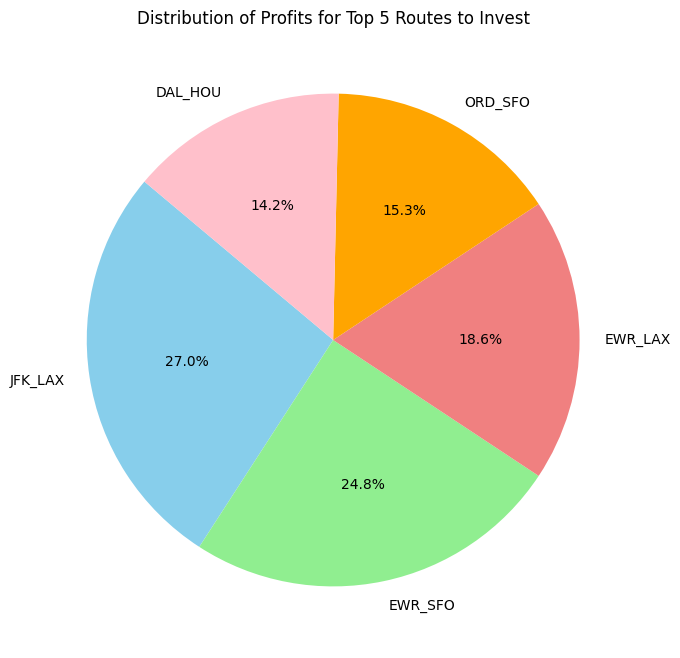

In [ ]:
import matplotlib.pyplot as plt

# Create a pie chart
plt.figure(figsize=(8, 8))
plt.pie(top_5_routes_to_invest['PROFIT'], labels=top_5_routes_to_invest['ROUND_TRIP_ROUTE'], colors=['skyblue', 'lightgreen', 'lightcoral', 'orange', 'pink'], autopct='%1.1f%%', startangle=140)
plt.title('Distribution of Profits for Top 5 Routes to Invest')

# Display the plot
plt.show()


# **Number of Round Trips to break-even**

In [ ]:
#NUMBER_OF_TRIPS_TO_BREAKEVEN= Profit per Trip/Cost of Airplane

​# Create a DataFrame from the provided data
data = {
    'ROUND_TRIP_ROUTE': ['JFK_LAX', 'EWR_SFO', 'EWR_LAX', 'ORD_SFO', 'DAL_HOU'],
    'PROFIT': [11050888.0, 10179912.0, 7623084.0, 6284580.0, 5837256.0]
}

recommended_routes = pd.DataFrame(data)

# Calculate NUMBER_OF_TRIPS_TO_BREAKEVEN
recommended_routes['NUMBER_OF_TRIPS_TO_BREAKEVEN'] = 90000000 / recommended_routes['PROFIT']

print("Top 5 recommended routes:")
print(recommended_routes[['ROUND_TRIP_ROUTE', 'PROFIT', 'NUMBER_OF_TRIPS_TO_BREAKEVEN']])


Top 5 recommended routes:
  ROUND_TRIP_ROUTE      PROFIT  NUMBER_OF_TRIPS_TO_BREAKEVEN
0          JFK_LAX  11050888.0                      8.144142
1          EWR_SFO  10179912.0                      8.840941
2          EWR_LAX   7623084.0                     11.806245
3          ORD_SFO   6284580.0                     14.320766
4          DAL_HOU   5837256.0                     15.418203


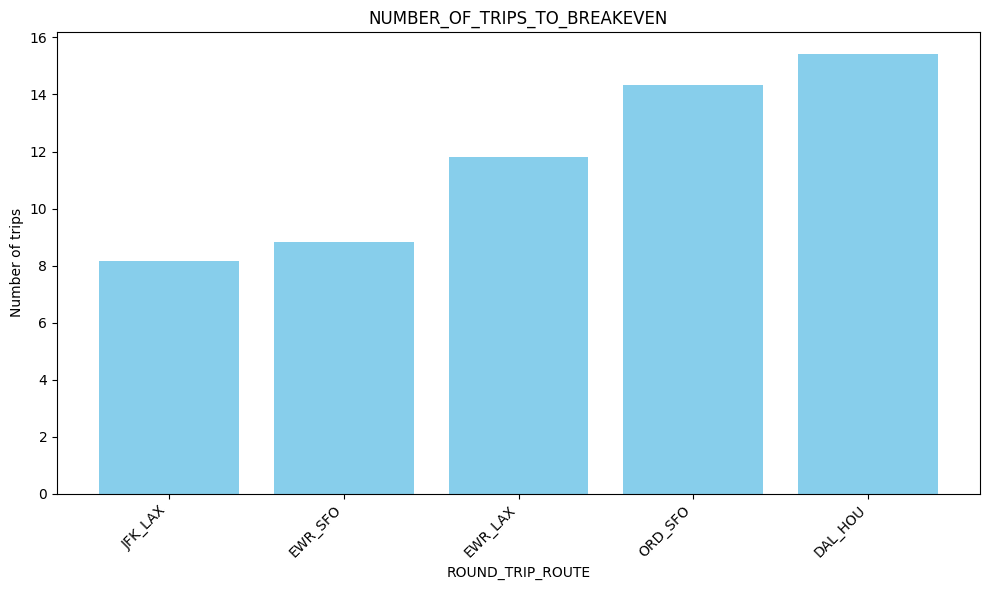

In [ ]:
# Create a bar plot
plt.figure(figsize=(10, 6))
plt.bar(recommended_routes['ROUND_TRIP_ROUTE'], recommended_routes['NUMBER_OF_TRIPS_TO_BREAKEVEN'], color='skyblue')
plt.xlabel('ROUND_TRIP_ROUTE')
plt.ylabel('Number of trips')
plt.title('NUMBER_OF_TRIPS_TO_BREAKEVEN')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Display the plot
plt.show()


# **Key performance indicators (KPI's)**

**Route Profitability**: Monitor the profitability of each round-trip route regularly.

**Load Factor:** Calculate the percentage of available seats filled with paying passengers for each round-trip route. A high load factor indicates that the route is in demand and operating efficiently.

**On-Time Performance**: Track the on-time performance of each round-trip route, measuring the percentage of flights that depart and arrive on schedule.

**Customer Retention Rate:** Track the percentage of customers who choose to fly the same route again.

**Cancellations and Delays:** Track the number of flight cancellations and delays for each route.

**Customer Reviews and Feedback:** Regularly analyze customer reviews and feedback for each route

# **Meta Data**

This section refers to all the extra columns and dataframes created in the data

**flights_with_airport_codes** - The flights and Aircode datasets were merged together on Origin from the flights data and IATA_CODE from Aircodes data.

**merged_data** - The flights_with_airport_codes data was merged  on tickets data using - 'FL_DATE', 'ORIGIN', 'DESTINATION', 'OP_CARRIER' from flights_with_airport_codes data,
        and 'YEAR', 'ORIGIN', 'DESTINATION', 'REPORTING_CARRIER' - from tickets data, and inner join was used.

**Columns**

* dest_orig - This is a combination of the origin and destination

*filtered_data - This was obtained after dropping some columns on merged_data

* filtered_on_size - This data filters on medium and large airports as well airports in the US.

**Columns**
* ROUND_TRIP_ROUTE column was created to by concatenating ORIGIN and DESTINATION together

* filtered_origin_dest
This was obtained by filtering on round trips

**Columns**
* TOTAL_REVENUE - This is the total revenue generated from passengers that boarded the flight. It is calculated using passengers and itin_fare
* TOTAL_COST - This is the total cost incurred by the airline. This was obtained using passengers, delay_cost_per_minute, baggage_check_probability, baggage_fee_per_bag.
* PROFIT - THis is the total revenue - total cost










## **Map of airports**

In [ ]:
import folium
import re

def create_airport_map(airport_df):
    # Create a map centered on the US
    map_airports = folium.Map(location=[37.0902, -95.7129], zoom_start=4)

    # Precompute the icon
    marker_icon = folium.Icon(color='blue')

    # Regular expression pattern to extract coordinates from a string
    coord_pattern = re.compile(r'([+-]?\d+\.\d+),\s*([+-]?\d+\.\d+)')

    # Extract coordinates as separate columns
    airport_df[['LATITUDE', 'LONGITUDE']] = airport_df['COORDINATES'].str.extract(coord_pattern)

    # Convert to float
    airport_df[['LATITUDE', 'LONGITUDE']] = airport_df[['LATITUDE', 'LONGITUDE']].astype(float)

    # Drop rows with missing coordinates
    airport_df.dropna(subset=['LATITUDE', 'LONGITUDE'], inplace=True)

    # Create a new DataFrame with only the needed columns
    airport_data = airport_df[airport_df['TYPE'] == 'medium_airport'][['IATA_CODE', 'LATITUDE', 'LONGITUDE']]

    # Iterate through rows and add markers for each airport
    for _, row in airport_data.iterrows():
        airport_name = row['IATA_CODE']
        airport_lat = row['LATITUDE']
        airport_lon = row['LONGITUDE']

        # Add a marker for each airport
        folium.Marker(
            location=[airport_lat, airport_lon],
            popup=airport_name,
            icon=marker_icon
        ).add_to(map_airports)

    return map_airports

# Replace 'filtered_origin_dest' with your actual DataFrame containing airport data
# You can now create the map by calling the function
filtered_origin_dest_copy = filtered_origin_dest.copy()  # Create a copy to avoid modifying original data
airport_map = create_airport_map(filtered_origin_dest_copy)

# Save the map to an HTML file
airport_map.save("medium_airport_locations_map.html")


In [ ]:
# Display the map
display(airport_map)